## Libraries

In [199]:
# basic use libraries
import re
import numpy as np
import datetime
import pandas as pd

# for dashboard
import panel as pn
import param

# for scraping the web
from bs4 import BeautifulSoup
import requests
from twitterscraper import query_tweets
import twitterscraper

# for visualizations
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline
from wordcloud import WordCloud

# file management
import csv
import json
import subprocess
import shutil

#for initial time-series modeling
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose as sd

In [6]:
# Facebook Prophet libraries
from fbprophet import Prophet
from fbprophet.plot import plot_plotly, plot_cross_validation_metric
from fbprophet.diagnostics import cross_validation, performance_metrics
import plotly.offline as py
pd.plotting.register_matplotlib_converters() #necessary to maintain pd.plotting functionality

# for NLP
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.stop_words import ENGLISH_STOP_WORDS
from textblob import TextBlob 

## Functions

In [7]:
def make_dates_list(year=2018):
    # define a list of dates for a given year
    dates_year =[str(date)[:10] for date in pd.date_range(start=f'1/1/{year}', end=f'12/31/{year}')]
    # define a list of dates for generating file names
    dates_stripped_year = [date.replace('-','') for date in dates_year]
    return dates_year, dates_stripped_year

In [8]:
# Define functions to clean tweets and get tweet sentiment

# portions of the code below comes from :
# https://towardsdatascience.com/extracting-twitter-data-pre-processing-and-sentiment-analysis-using-python-3-0-7192bd8b47cf
def replace_emoticons(tweet):
    "This code replaces happy and sad emoticons with the words 'HAPPY' and 'SAD'"
    rhappy = '[' + re.escape(''.join(emoticons_happy)) + ']'
    re.sub(rhappy, ' HAPPY ', tweet)
    rsad = '[' + re.escape(''.join(emoticons_sad)) + ']'
    re.sub(rsad, ' SAD ', tweet)
    return tweet

def clean_tweet(tweet): 
    ''' 
    Utility function to clean tweet text by removing links, usernames, and
    special characters using simple regex statements. 
    '''
    tweet = replace_emoticons(tweet)
    # p.set_options(p.OPT.URL, p.OPT.EMOJI, p.OPT.MENTION)
    # tweet = p.clean(tweet)
    tweet = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t]) \
                            |(\w+:\/\/\S+)", " ", tweet).split())
    return tweet

def double_clean_tweet(tweet):
    "This function goes a little further than the previous clean function"
    #removing mentions
    tweet = re.sub(r':', ' ', tweet)
    tweet = re.sub(r'‚Ä¶', ' ', tweet)
    #replace consecutive non-ASCII characters with a space
    tweet = re.sub(r'[^\x00-\x7F]+',' ', tweet)
    #remove emojis from tweet  (unless you want to later go through the UNICODE
    # charts and separate "happy" emojis from "sad" emojis and add them to 
    # the `replace_emoticons()` function)
    tweet = emoji_pattern.sub(r'', tweet)
    return tweet


# Sentiment analysis code below adapted from:
# https://www.geeksforgeeks.org/twitter-sentiment-analysis-using-python/
def get_tweet_sentiment(tweet): 
    ''' 
    Utility function to classify sentiment of passed tweet 
    using textblob's sentiment method 
    '''
    # create TextBlob object of passed tweet text 
    analysis = TextBlob(tweet)
    # set sentiment 
    polarity = analysis.sentiment.polarity
    subjectivity = analysis.sentiment.subjectivity
    if analysis.sentiment.polarity > 0.1: 
        sentiment = 'positive'
    elif analysis.sentiment.polarity < -0.1: 
        sentiment = 'negative'
    else: 
        sentiment = 'neutral'
    return sentiment, polarity, subjectivity

In [9]:
# define a function to create a .CSV file that compiles the relevant 
# info from the JSONs, preprocesses the tweets, and performs sentiment analysis
def json_to_csv_tweets(output_filename='output.csv', year=2018):
    """
    Takes in JSON files of scraped tweets from the `./data/` folder,
    cleans the tweets, performs sentiment analysis, and then outputs
    the results to the provided destination CSV filename.
    """
    # create the csv writer object
    csvwriter = csv.writer(open(output_filename, 'w', newline=''))
    csvwriter.writerow(["timestamp", "text", "sentiment", "polarity", "subjectivity", "tally"])

    # iterate adding rows of JSON to the CSV file
    dates_year, dates_stripped_year = make_dates_list(year)
    for i in dates_stripped_year:
        f = open(f'./data/t{i}.json')
        data = json.load(f)
        for tweet in data:
            tw = tweet["text"]
            tw = replace_emoticons(tw)
            tw = clean_tweet(tw)
            tw = double_clean_tweet(tw)
            sentiment, polarity, subjectivity = get_tweet_sentiment(tw)
            csvwriter.writerow([i, tw, sentiment, polarity, subjectivity, 1])
        f.close()
        if float(i)%20 == 0:
            print(f"Finished working with:   ./data/t{i}.json")
    print("JOB IS COMPLETELY FINISHED.  HOORAY!!")
    pass

In [10]:
# Define functions to scrape and clean financial data for a given year
def fetch_data(symbol, object_type, stocks_apikey):
    # Making an API request for a certain stock's history
    if object_type == 'currency':
        credentials = {'function':'FX_DAILY', 
                       'from_symbol':symbol, 
                       'to_symbol':'USD', 
                       'outputsize':'full',
                       'apikey':stocks_API_key}
    elif object_type == 'cryptocurrency':
        credentials = {'function':'DIGITAL_CURRENCY_DAILY', 
                       'symbol':symbol, 
                       'market':'USD', 
                       'apikey':stocks_API_key}
    else:
        credentials = {'function':'TIME_SERIES_DAILY',
                       'symbol':symbol,
                       'outputsize':'full',
                       'apikey':stocks_apikey}

    r = requests.get('https://www.alphavantage.co/query', params=credentials)
    # checking to make sure request was successful
    print(r.status_code)
    if r.status_code == requests.codes.ok:
        print("Request Successful")
    return r


def clean_financials(r, object_type):
    # cleaning up the data to make it easier to work with
    if object_type == 'currency':
        df = pd.DataFrame(r.json()["Time Series FX (Daily)"])
    elif object_type == 'cryptocurrency':
        df = pd.DataFrame(r.json()["Time Series (Digital Currency Daily)"])
    elif object_type in ['stock','index']:
        df = pd.DataFrame(r.json()["Time Series (Daily)"])

    df = df.T.reset_index()

    if object_type == 'cryptocurrency':
        df.drop(columns=["1b. open (USD)","2b. high (USD)","3b. low (USD)",
            "4b. close (USD)","6. market cap (USD)"], inplace=True, axis=1)

    if object_type == 'currency':
        df.columns = ['date','open','high','low','close']
        df.date = pd.to_datetime(df.date)
        df[['open','high','low','close']] = df[['open',
            'high','low','close']].astype(float)
    else:
        df.columns = ['date','open','high','low','close','volume']
        df.date = pd.to_datetime(df.date)
        df[['open','high','low','close','volume']] = df[['open',
            'high','low','close','volume']].astype(float)

    # create a new column to account for after-hours trading
    # this uses the next day's open value as the prior day's close value
    cl24 = [df.loc[0].close]
    for val in df.open.values:
        cl24.append(val)
    cl24 = pd.DataFrame(cl24[:-1], columns=['close_24'])
    df = df.join(cl24)

    # now we must account for when afterhours trading exceeds high/low values
    df['high_24'] = df[['high', 'close_24']].values.max(1)
    df['low_24'] = df[['low', 'close_24']].values.min(1)
    # and add a few more columns that should be useful
    df['range'] = df['high'] - df['low']
    df['range_24'] = df['high_24'] - df['low_24']
    df['change_24'] = df['close_24'] - df['open']
    # setting date column as index to facilitate timeseries manipulation
    df.set_index('date', inplace=True)
    return df
    

def get_financial_data(symbol, object_type, stocks_apikey, year=2018, verbose=True):
    """
    Inputs:
    symbol         (string) Stock or Currency symbol
    object_type    (string) must be one of these:
                      'stock'
                      'index'
                      'currency'
                      'cryptocurrency'
    stocks_apikey  (string) your API key for 
                      https://www.alphavantage.co
    year           (int) the year you wish to examine
    verbose        if True, displays .info() and .head() of data
    =========================================
    Returns a DataFrame of daily financial information containing
    at least opening, closing, high, and low values.
    """
    valid_types = ['stock','index','currency','cryptocurrency']
    if object_type in valid_types:
        r = fetch_data(symbol, object_type, stocks_apikey)
        df = clean_financials(r, object_type)    #cleaning data
        year_df = df[f'{year}':f'{year}']        # getting 1 year's data
        if verbose:
            display(year_df.head(),year_df.info())
        plt.figure(figsize=(15,5))
        plt.plot(year_df['close_24'])
        plt.title(f"{symbol} Daily Performance for {year}", fontsize=16)
        plt.ylabel("Price (in USD)");
        return year_df
    else:
        print("""
        Invalid entry for 'object_type', must be one of these strings:
                'stock'
                'index'
                'currency'
                'cryptocurrency'
        """)
        pass

In [11]:
# Define a function to decompose a time series, in order to detect
# trends and seasonality, and allow for examining the residuals
def df_decompose(df):
    # Gather the trend, seasonality and noise of decomposed object
    trend = sd(df).trend
    seasonal = sd(df).seasonal
    residual = sd(df).resid

    # Plot gathered statistics
    plt.figure(figsize=(12,8))
    plt.title(f"Decomposition for {df}")
    plt.subplot(411)
    plt.plot(df, label='Original', color="blue")
    plt.legend(loc='best')
    plt.subplot(412)
    plt.plot(trend, label='Trend', color="blue")
    plt.legend(loc='best')
    plt.subplot(413)
    plt.plot(seasonal, label='Seasonality', color="blue")
    plt.legend(loc='best')
    plt.subplot(414)
    plt.plot(residual, label='Residuals', color="blue")
    plt.legend(loc='best')
    plt.tight_layout();
    
    return residual.dropna()

In [12]:
# let's plot sentiment trends
def plot_sentiments(csv_filename):
    year=2018
    tweets_df = pd.read_csv(csv_filename)
    tweets_df.timestamp = pd.to_datetime(tweets_df.timestamp, format='%Y%m%d')
    grouped = pd.DataFrame(tweets_df.groupby(['timestamp', 'sentiment'])['tally'].sum()).reset_index()
    for sentiment in grouped.sentiment.unique():
        temp_df = grouped[grouped.sentiment == sentiment].set_index('timestamp')
        temp_df['tally'].plot(figsize=(15,8), label=sentiment)
        plt.ylabel("Number of Tweets by Sentiment\n(~1,000/day total)", fontsize=16)
        plt.title(f"Daily Sentiment at midnight (UTC) in {year}", fontsize=20)
    plt.legend();

In [13]:
# Define functions to automate the process of inspecting lunar trends

def get_lunar_phases(year='2018'):
    "Given a year, returns a dataframe of lunar phases, dates, and times (UTC)."
    url = f"https://aa.usno.navy.mil/cgi-bin/aa_phases.pl?year={year}&nump=65&format=t"
    res_page = requests.get(url)
    soup = BeautifulSoup(res_page.content, 'html.parser')
    table_cells = soup.find_all("td")
    output = pd.DataFrame(columns=['phase','date','time'])
    for i in range(len(table_cells)):
        row = np.floor(i/2)
        if i%2 == 0:
            output.at[row,'phase'] = table_cells[i].text
        else:
            output.at[row,'date'] = table_cells[i].text[:12]  #need to grab just beggining of string
            output.at[row,'time'] = table_cells[i].text[-5:]  #need to grab just ending of string
    output.date = pd.to_datetime(output.date)
    output.reset_index(drop=True, inplace=True)
    return output


def lunar_phase_separator(phases_df, lower_window=0, upper_window=1):
    """
    Converts DataFrame of moon phases into FBProphet-friendly format.
    ---------------------
    Inputs:
    phases_df       DataFrame containing lunar phase dates for a given year
                        (the output of the `get_lunar_phases()` function)
    lower_window    (<=0) number of days prior to moon phase to include in 'holiday'
    upper_window    (>=0) number of days after to moon phase to include in 'holiday'
    ---------------------
    Returns:        FBProphet-friendly DataFrame for use in 'holiday' parameter
    """
    # let's separate the different moon phases
    phase_names = ['Full Moon','Last Quarter','New Moon','First Quarter']
    ph_list = []
    for phase in phase_names:
        moons = pd.DataFrame(phases_df.loc[phases_df['phase'] == phase]['date']).reset_index(drop=True)
        moons.columns = ['ds']
        moons['holiday'] = str(phase).lower().replace(" ", "")
        moons['lower_window'] = lower_window
        moons['upper_window'] = upper_window
        ph_list.append(moons)
    phases = pd.concat((ph_list[0], ph_list[1], ph_list[2], ph_list[3]))
    return phases

In [14]:
# Define functions to automate the process of inspecting lunar trends
def prep_data_for_FBP(data, column_name):
    """
    Given a DataFrame and the name of the column to be processed, 
    generates a FBProphet-ready DataFrame.
    """
    d = data.reset_index()
    prepped_data = d[['date', column_name]].sort_values(by=['date']).reset_index(drop=True)
    prepped_data.columns = ['ds','y']
    return prepped_data


def cross_val_FBP(model, metric='rmse', show_metric_scores=False):
    # cross validating using time horizons within the dataset
    df_cv = cross_validation(model, initial='90 days', period='15 days', horizon = '30 days')
    # performance metrics for the FBProphet model
    df_p = performance_metrics(df_cv)
    if show_metric_scores == True:
        display(df_p.head())
    # plotting performance metrics
    fig = plot_cross_validation_metric(df_cv, metric)
    pass


def get_weekends(year='2018'):
    weekends_df = pd.DataFrame(columns=['date','day_of_week'])
    weekends_df.date = [date for date in pd.date_range(start=f'1/1/{year}', periods=470)]
    weekends_df.day_of_week = [datetime.datetime(int(str(date)[:4]), 
        int(str(date)[5:7]), int(str(date)[8:10])).weekday() for date in weekends_df.date]
    weekends_df = weekends_df[weekends_df.day_of_week >= 5].reset_index(drop=True)
    return weekends_df


def lunar_stock_trend(df, column_name, phases_df, year='2018', lower_window=0, 
                      upper_window=1, trades_on_weekends=False,
                      cross_val=True, metric='rmse',
                      show_metric_scores=False):
    """
    This function takes in a DataFrame of stock data and the 
    column name for the feature to be examined, a DataFrame of lunar 
    phases for a year, the desired year, and the lower & upper 
    windows for 'holiday' dates.
    
    If the financial data contains values for weekends, set the
    'trades_on_weekends' parameter to 'True'.
    
    Additional option to cross-validate FBProphet model predictions, and
    select from a variety of metrics to use.
    
    ----------------------------------------------------
    
    Returns a list containing the model object, the 'future' dataframe
    used to make predictions, the forecast output DataFrame, a graph
    of the forecast, and a graph of forecast components.
    """
    phases = lunar_phase_separator(phases_df, lower_window, upper_window)
    if trades_on_weekends == False:
        weekends_df = get_weekends(year)
        phases = phases[~phases['ds'].isin(weekends_df.date)]
    data = prep_data_for_FBP(df, column_name)
    m = Prophet(holidays=phases)
    m.fit(data)
    future = m.make_future_dataframe(periods=60, freq='D')
    if trades_on_weekends == False:
        future = future[~future['ds'].isin(weekends_df.date)]
    forecast = m.predict(future)
    disp_length = 4 * (1 + abs(lower_window) + abs(upper_window))
    display(forecast[(forecast['fullmoon'] + forecast['lastquarter'] + 
                      forecast['newmoon'] + forecast['firstquarter']).abs() > 
                     0][['ds', 'fullmoon', 'lastquarter', 'newmoon',
                         'firstquarter']][:disp_length])        
    fig1 = m.plot(forecast);
    fig1.set_size_inches(15, 5);
    fig2 = m.plot_components(forecast)
    fig2.set_size_inches(15, 10);
    if cross_val:
        cross_val_FBP(m, metric, show_metric_scores)
        
    return [m, future, forecast, fig1, fig2]

In [29]:
def tweet_fbprophet(filename='tweets_nowords_2018.csv'):
    print(filename)
    tweets_df = pd.read_csv(filename)
    tweets_df.timestamp = pd.to_datetime(tw_df.timestamp, format='%Y%m%d')
    grouped = pd.DataFrame(tweets_df.groupby(['timestamp', 'sentiment'])['tally'].sum()).reset_index()

    #prepare grouped sentiment data for FBProphet processing
    #here, positive sentiment only
    grp_pos = grouped[grouped.sentiment == 'positive'].drop('sentiment', axis=1).reset_index(drop=True)
    grp_pos.columns = ['ds','y']

    m = Prophet(holidays=phases)
    m.fit(grp_pos)
    future = m.make_future_dataframe(periods=60, freq='D')
    forecast = m.predict(future)
    forecast[(forecast['fullmoon'] + forecast['lastquarter'] + 
              forecast['newmoon'] + forecast['firstquarter']).abs() > 
             0][['ds', 'fullmoon', 'lastquarter', 'newmoon','firstquarter']][:10]
    fig1 = m.plot(forecast);
    fig1.set_size_inches(15, 5);
    fig2 = m.plot_components(forecast)
    fig2.set_size_inches(15, 10);
    
    # cross validating using time horizons within the dataset
    df_cv = cross_validation(m, initial='90 days', period='15 days', horizon = '30 days')
#     # performance metrics for the FBProphet model
#     df_p = performance_metrics(df_cv)
#     display(df_p.head())

    # plotting performance metrics
    fig3 = plot_cross_validation_metric(df_cv, metric='rmse')

In [16]:
# function to get most frequent words
def get_top_n_words(corpus, stopwords):
    vec = CountVectorizer(stop_words=stopwords).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq


# function for plotting the most frequent words
def plot_phase_words(corpus, keywords, phase, stopwords, n=None):
    comm_words = get_top_n_words(corpus.text, stopwords)[:n]
    df2 = pd.DataFrame(comm_words, columns=['text', 'count'])
    total = df2['count'].sum()   ###################    
    # plotting
    fig, ax = plt.subplots(figsize=(15,5))
    plt.xticks(rotation=30, fontsize=14)
    hghts = ((df2['count'] / total) * 100)
    rects = ax.bar(df2.text, hghts)                                                  #################
    ax.set_title(f"Top {n} Words for {phase} at Midnight UTC", fontsize=16)
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width(), 1.005*height,
                f'{np.round(height, 2)}%', ha='right', va='bottom')
    plt.plot([], [], ' ', label=f"Search Keywords:\n{keywords}")
    plt.legend(fontsize=14)
    plt.show();


# function to parse a CSV file and then plot all results
def plot_CSV_words(filename, keywords, phases_df, n=None):
    """
    Inputs:
    filename       (str) CSV filename generated from Twitter scraping function
    keywords       (str) the query keywords used in Twitter scraping function
    phases_df      (df) dataframe of lunar phases for a given year
    n              (int) number of most common words to return
    ==================================================
    Returns:
    Histograms (5 total) of the 'n' most common words for each lunar phase and for
    all the nights not in a lunar phase.
    """
    df = pd.read_csv(filename)
    df.dropna(inplace=True)
    df.timestamp = pd.to_datetime(df.timestamp, format='%Y%m%d')  
    stopwords = set(ENGLISH_STOP_WORDS)
    # now add extra things to that list that we want to filter out
    stopwords.update(['twitter','com','pic','ve','ll','just','like','don','really','00'])
    df.set_index('timestamp', inplace=True)
    
    phase_list = ['Full Moon','Last Quarter','New Moon','First Quarter','No Phase']
    for phase in phase_list:
        all_moons = list(phases_df.date.astype(str))
        if phase != 'No Phase':
            moon = list(phases_df[phases_df.phase == phase].date.astype(str))
            moon_data = df.loc[df.index.floor('D').isin(moon)]
            plot_phase_words(moon_data, keywords, phase, stopwords, n=n)
        else:
            moon_data = df.loc[~df.index.floor('D').isin(all_moons)]
            plot_phase_words(moon_data, keywords, phase, stopwords, n=n)

In [18]:
phases_2018_df = get_lunar_phases(year='2018')
phases = lunar_phase_separator(phases_2018_df, lower_window=0, upper_window=1)

In [19]:
tw_df = pd.read_csv('tweets_happysad_2018.csv')
tw_df.timestamp = pd.to_datetime(tw_df.timestamp, format='%Y%m%d')
grouped = pd.DataFrame(tw_df.groupby(['timestamp', 'sentiment'])['tally'].sum()).reset_index()

In [13]:
# for sentiment in grouped.sentiment.unique():
#     print(sentiment)
#     df_decompose(t2018_log[sentiment])

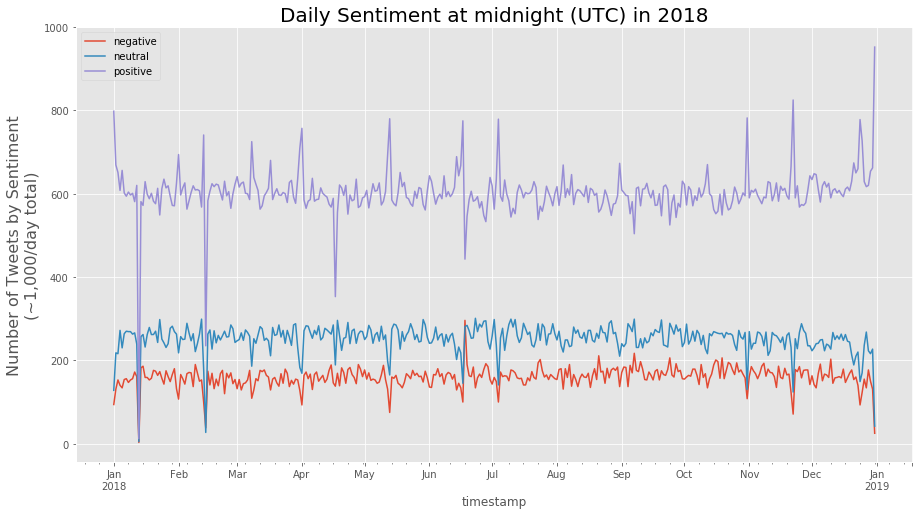

In [20]:
plot_sentiments('tweets_happysad_2018.csv', 2018)

In [22]:
stocks_API_key = 

200
Request Successful
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 251 entries, 2018-12-31 to 2018-01-02
Data columns (total 11 columns):
open         251 non-null float64
high         251 non-null float64
low          251 non-null float64
close        251 non-null float64
volume       251 non-null float64
close_24     251 non-null float64
high_24      251 non-null float64
low_24       251 non-null float64
range        251 non-null float64
range_24     251 non-null float64
change_24    251 non-null float64
dtypes: float64(11)
memory usage: 23.5 KB


,open,high,low,close,volume,close_24,high_24,low_24,range,range_24,change_24
date,,,,,,,,,,,
2018-12-31,101.2871,102.40,100.44,101.57,33173800.0,99.5500,102.40,99.55,1.96,2.85,-1.7371
2018-12-28,102.0900,102.41,99.52,100.39,38196300.0,101.2871,102.41,99.52,2.89,2.89,-0.8029
2018-12-27,99.3000,101.19,96.40,101.18,49498500.0,102.0900,102.09,96.40,4.79,5.69,2.7900
2018-12-26,95.1400,100.69,93.96,100.56,51634800.0,99.3000,100.69,93.96,6.73,6.73,4.1600
2018-12-24,97.6800,97.97,93.98,94.13,43935200.0,95.1400,97.97,93.98,3.99,3.99,-2.5400


None

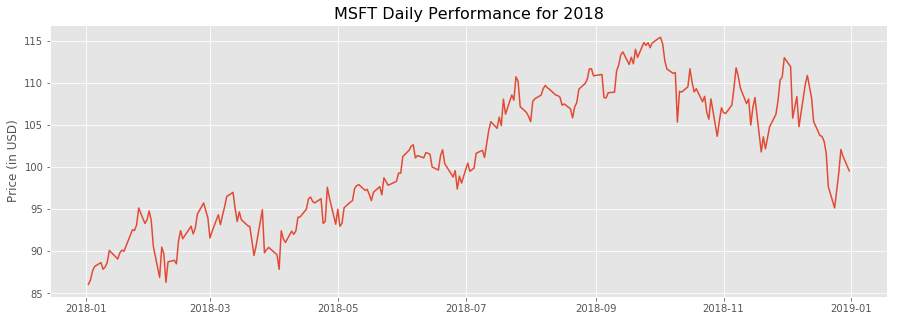

In [23]:
MSFT_2018 = get_financial_data('MSFT', 'stock', stocks_API_key, year=2018)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-02,-0.311006,0.000000,0.000000,0.000000
1,2018-01-03,-0.048920,0.000000,0.000000,0.000000
4,2018-01-08,0.000000,0.776920,0.000000,0.000000
5,2018-01-09,0.000000,-0.845515,0.000000,0.000000
9,2018-01-16,0.000000,0.000000,0.862164,0.000000
10,2018-01-17,0.000000,0.000000,0.281802,0.000000
11,2018-01-18,0.000000,0.000000,-1.051392,0.000000
14,2018-01-23,0.000000,0.000000,0.000000,-0.005672
15,2018-01-24,0.000000,0.000000,0.000000,1.003438
16,2018-01-25,0.000000,0.000000,0.000000,-0.216455


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


[<fbprophet.forecaster.Prophet at 0x143368b6208>,             ds
 0   2018-01-02
 1   2018-01-03
 2   2018-01-04
 3   2018-01-05
 4   2018-01-08
 5   2018-01-09
 6   2018-01-10
 7   2018-01-11
 8   2018-01-12
 9   2018-01-16
 10  2018-01-17
 11  2018-01-18
 12  2018-01-19
 13  2018-01-22
 14  2018-01-23
 15  2018-01-24
 16  2018-01-25
 17  2018-01-26
 18  2018-01-29
 19  2018-01-30
 20  2018-01-31
 21  2018-02-01
 22  2018-02-02
 23  2018-02-05
 24  2018-02-06
 25  2018-02-07
 26  2018-02-08
 27  2018-02-09
 28  2018-02-12
 29  2018-02-13
 ..         ...
 271 2019-01-21
 272 2019-01-22
 273 2019-01-23
 274 2019-01-24
 275 2019-01-25
 278 2019-01-28
 279 2019-01-29
 280 2019-01-30
 281 2019-01-31
 282 2019-02-01
 285 2019-02-04
 286 2019-02-05
 287 2019-02-06
 288 2019-02-07
 289 2019-02-08
 292 2019-02-11
 293 2019-02-12
 294 2019-02-13
 295 2019-02-14
 296 2019-02-15
 299 2019-02-18
 300 2019-02-19
 301 2019-02-20
 302 2019-02-21
 303 2019-02-22
 306 2019-02-25
 307 2019-02-26
 308 20

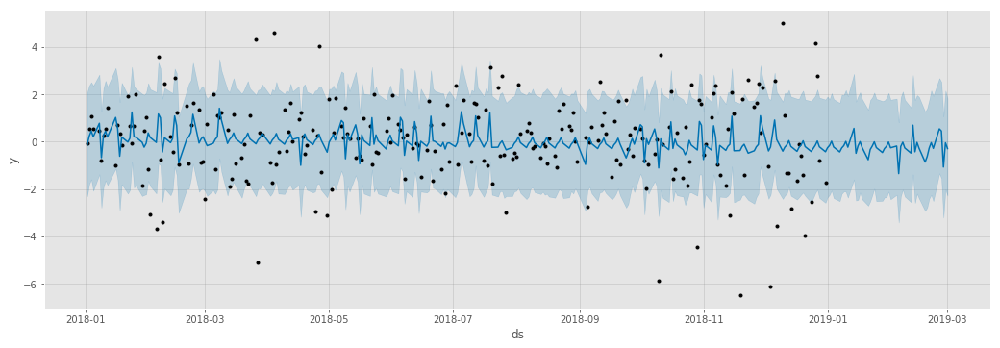

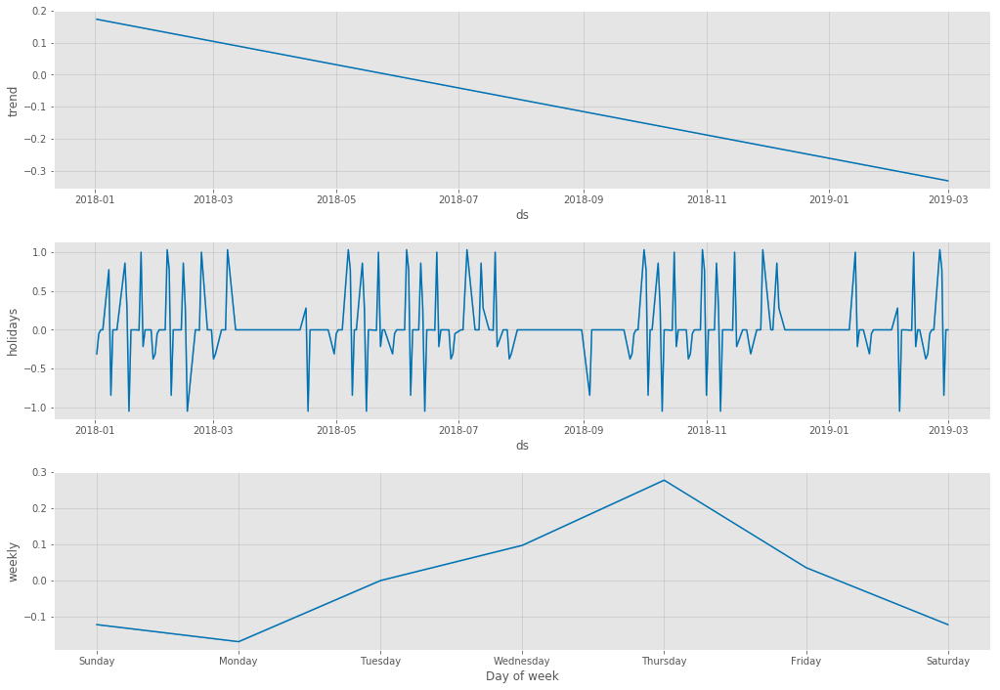

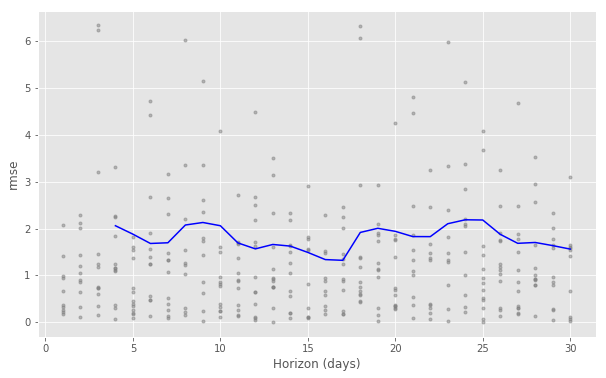

In [24]:
lunar_stock_trend(df=MSFT_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=False,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

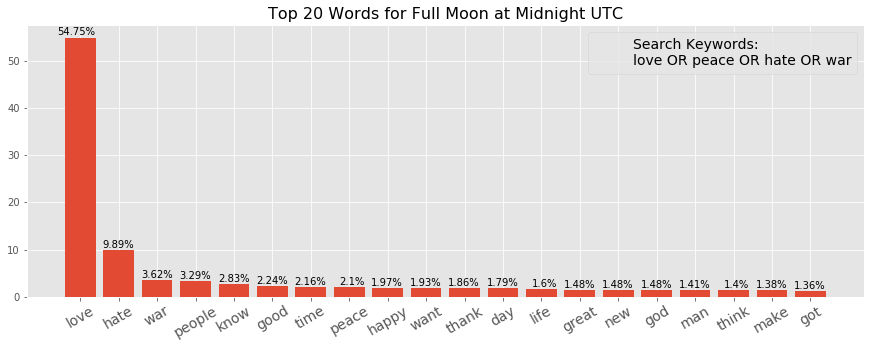

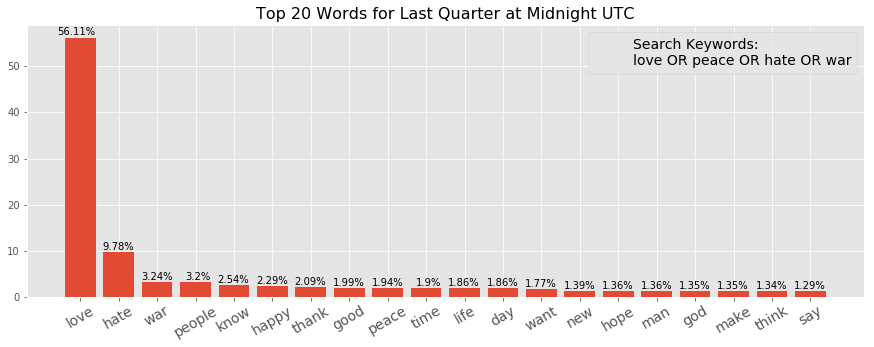

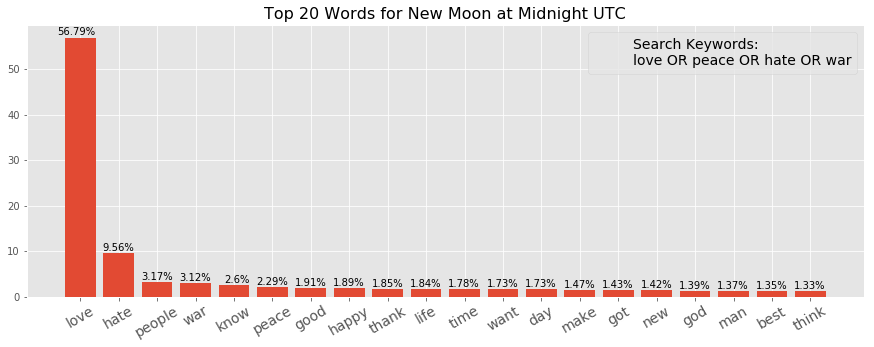

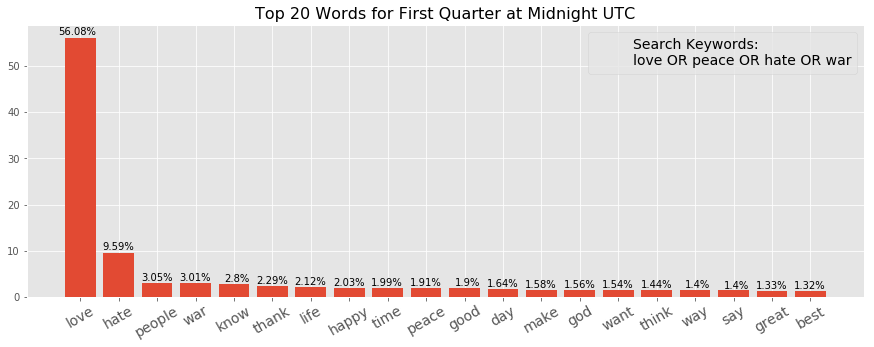

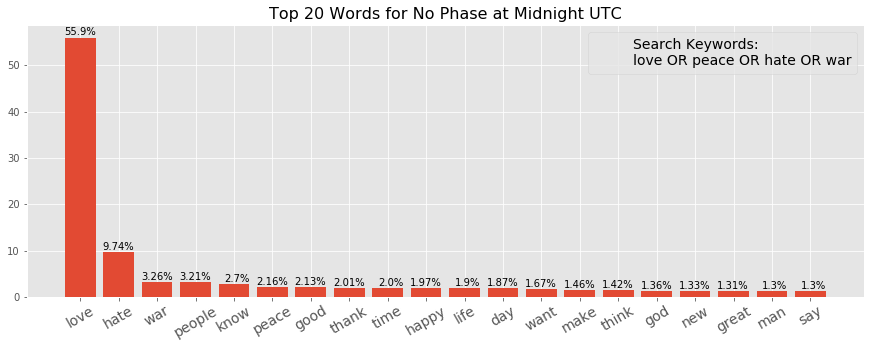

...

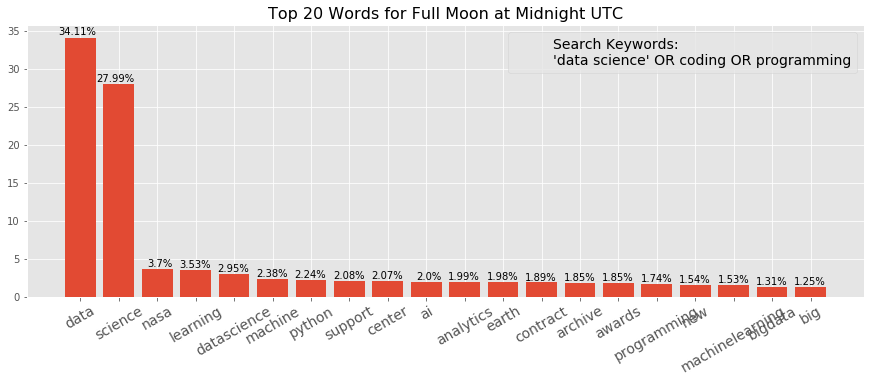

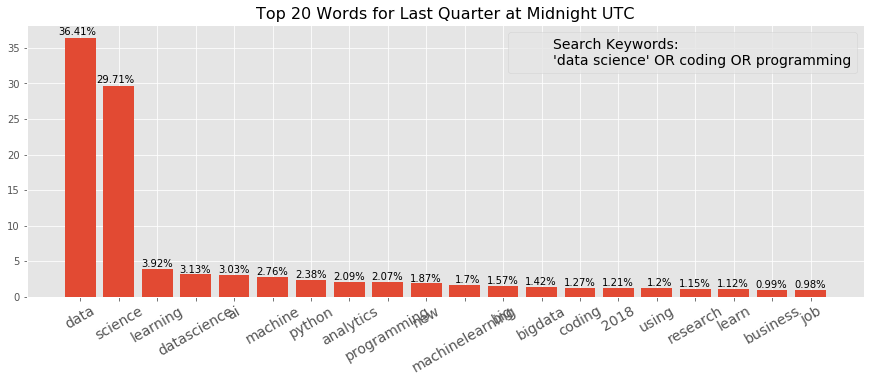

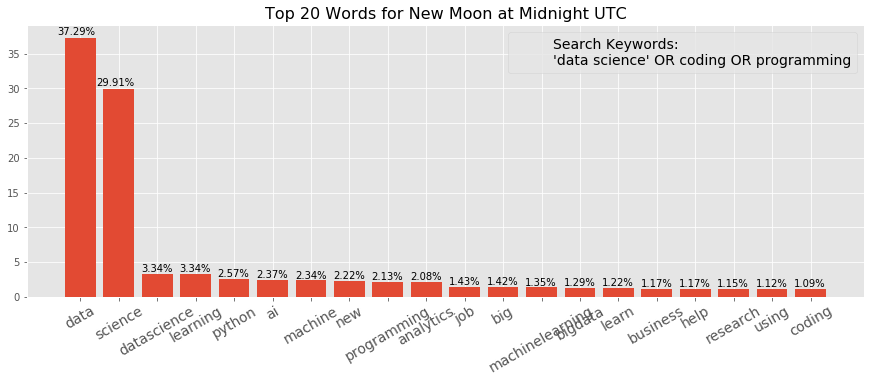

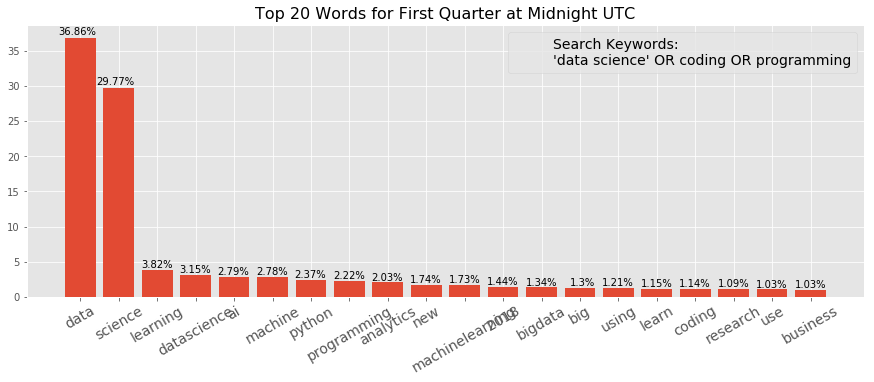

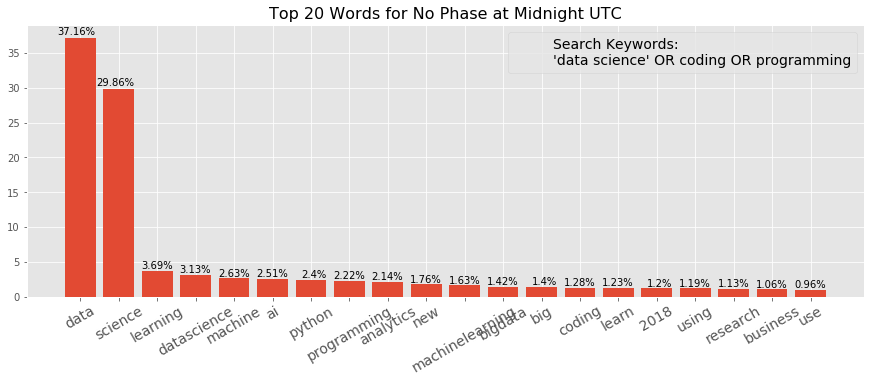

In [25]:
tweet_csv_files = ['tweets_lovehate_2018.csv',
                   'tweets_happysad_2018.csv',
                   'tweets_music_2018.csv',
                   'tweets_money_2018.csv',
                   'tweets_nowords_2018.csv',
                   'tweets_politics_2018.csv',
                   'tweets_coding_2018.csv']

queries = ['love OR peace OR hate OR war',
           'happy OR sad OR life OR death',
           'music OR tunes OR dance',
           'stocks OR money OR taxes',
           '(no keywords entered)',
           'politics OR government OR Trump',
           "'data science' OR coding OR programming"] 

for filename, key_words in zip(tweet_csv_files, queries):
    plot_CSV_words(filename=filename,
                   keywords=key_words,
                   phases_df=phases_2018_df,
                   n=20)

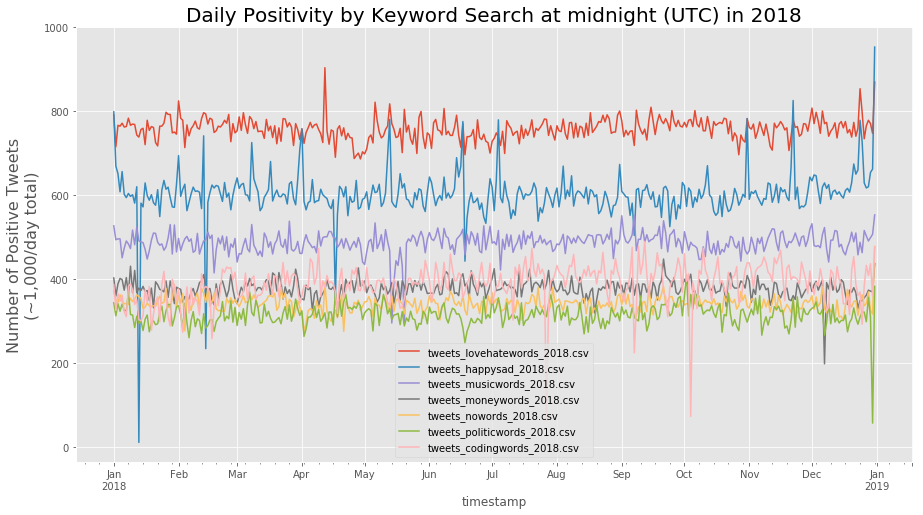

In [26]:
# Exploring daily positivity rates by query phrase....aggregated
for search in tweet_csv_files:
    plot_sentiments(search, 2018, positive_only=True)

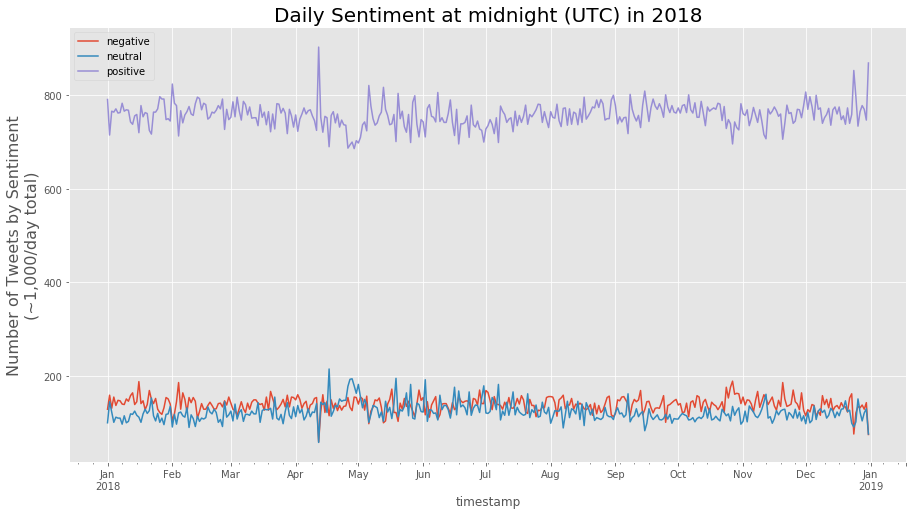

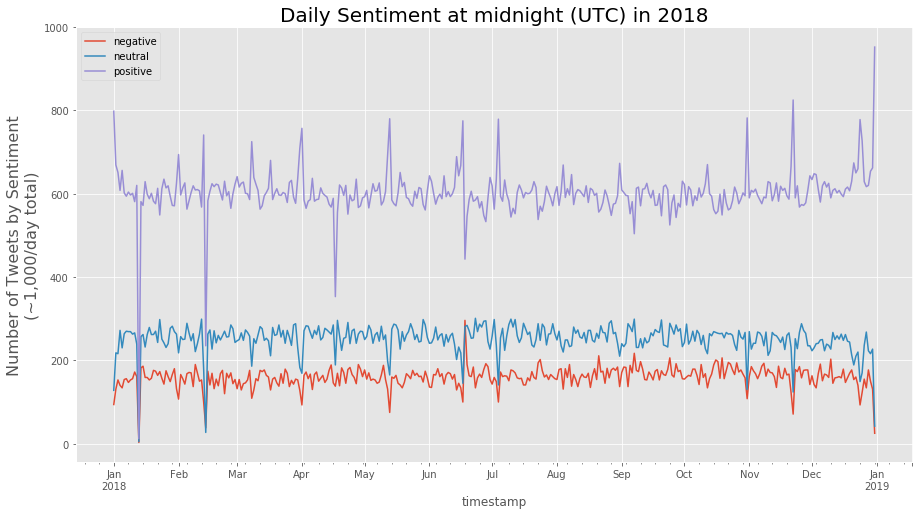

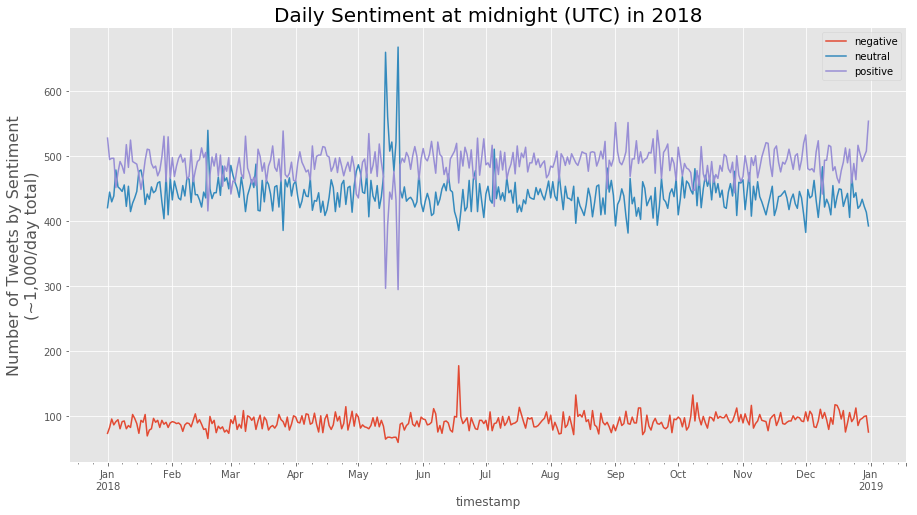

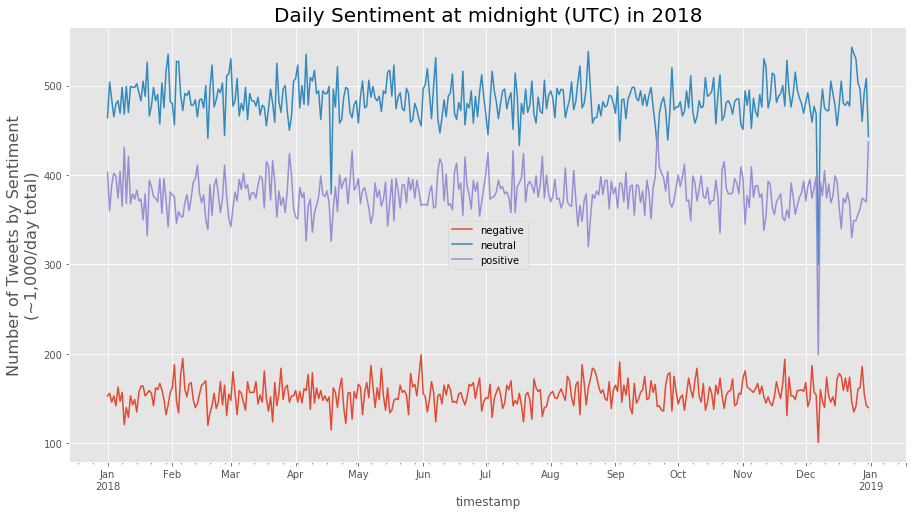

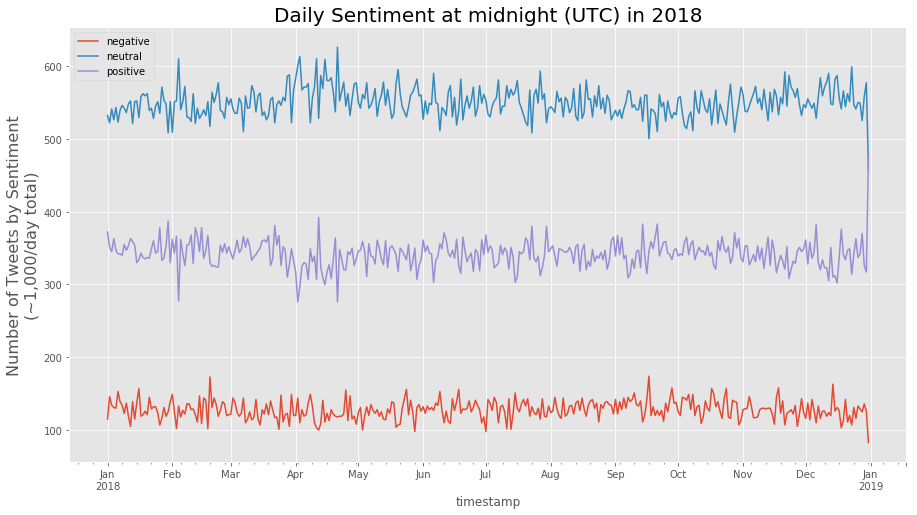

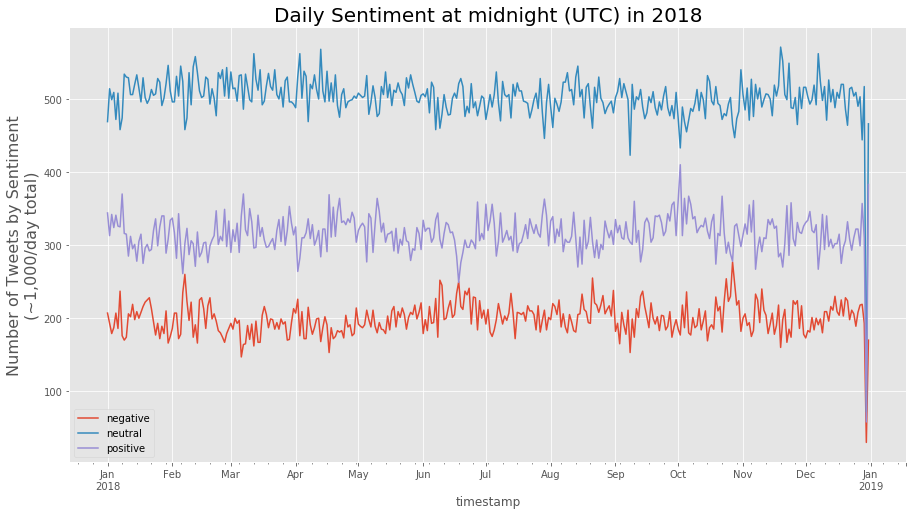

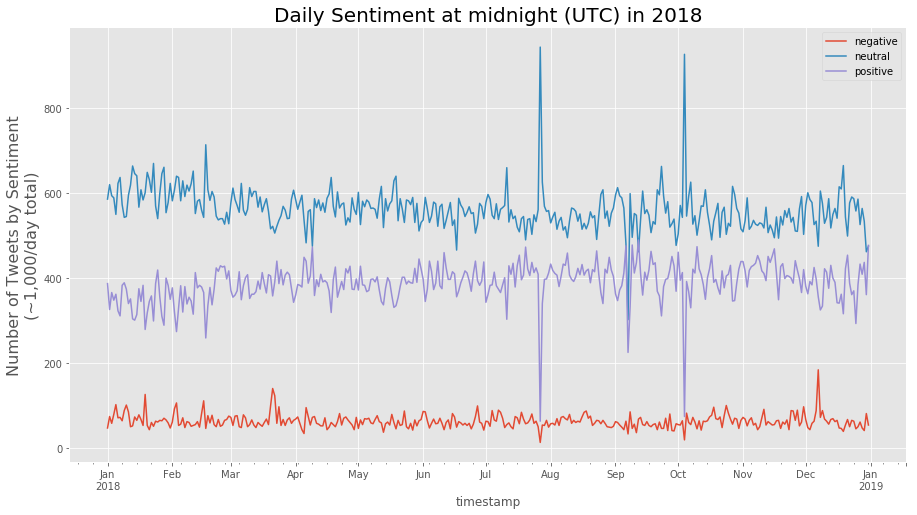

In [27]:
# Showing graphs for each query separately
for search in tweet_csv_files:
    plot_sentiments(csv_filename=search, year=2018, positive_only=False)
    plt.show();

tweets_lovehatewords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_happysad_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_musicwords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_moneywords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_nowords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_politicwords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_codingwords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00
C:\Users\Matthew Parker\.conda\envs\capstone-env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



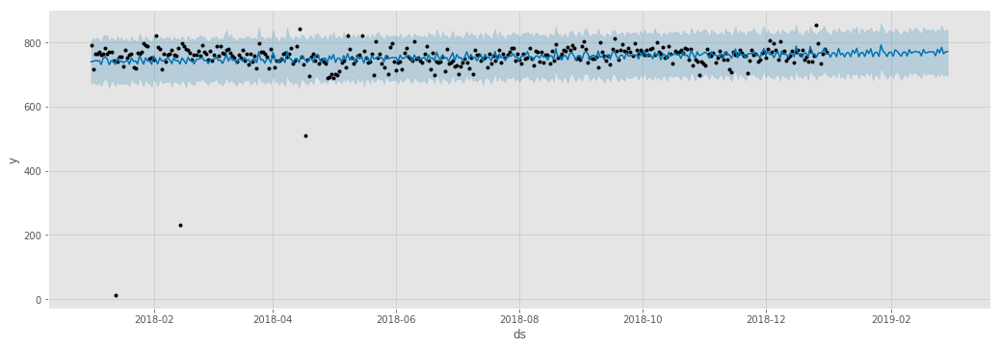

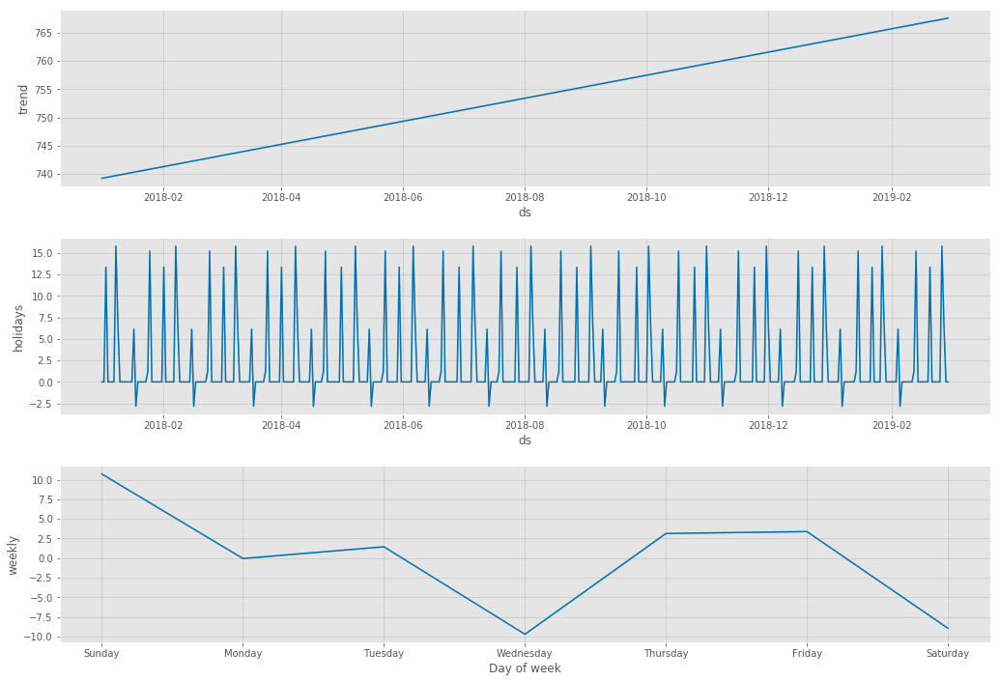

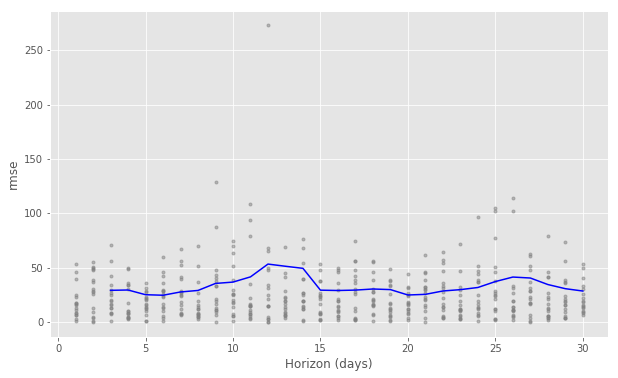

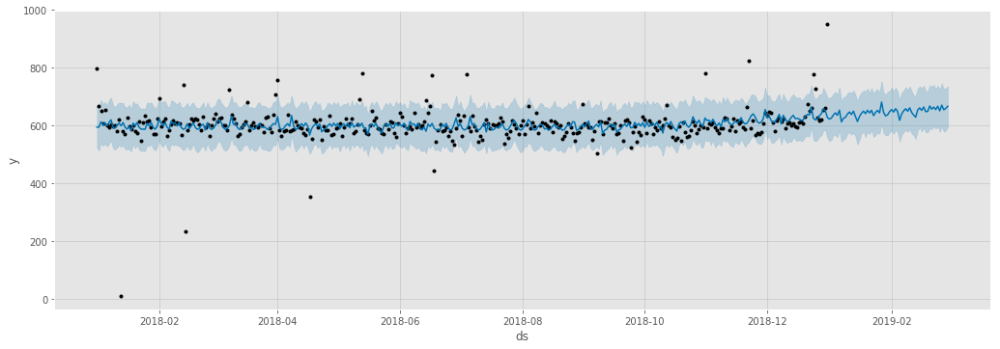

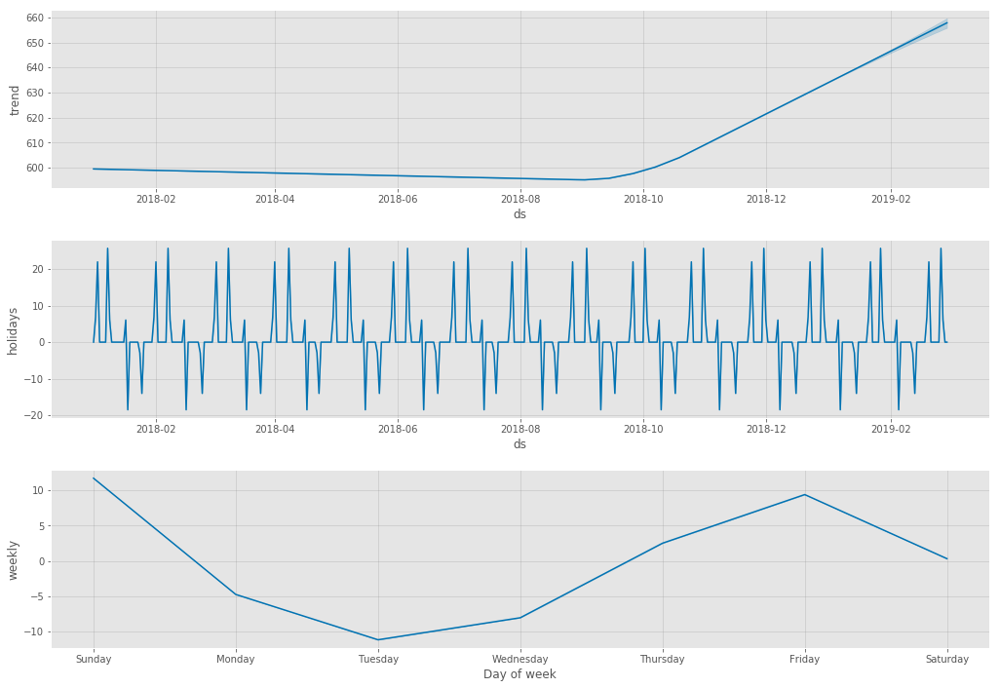

...

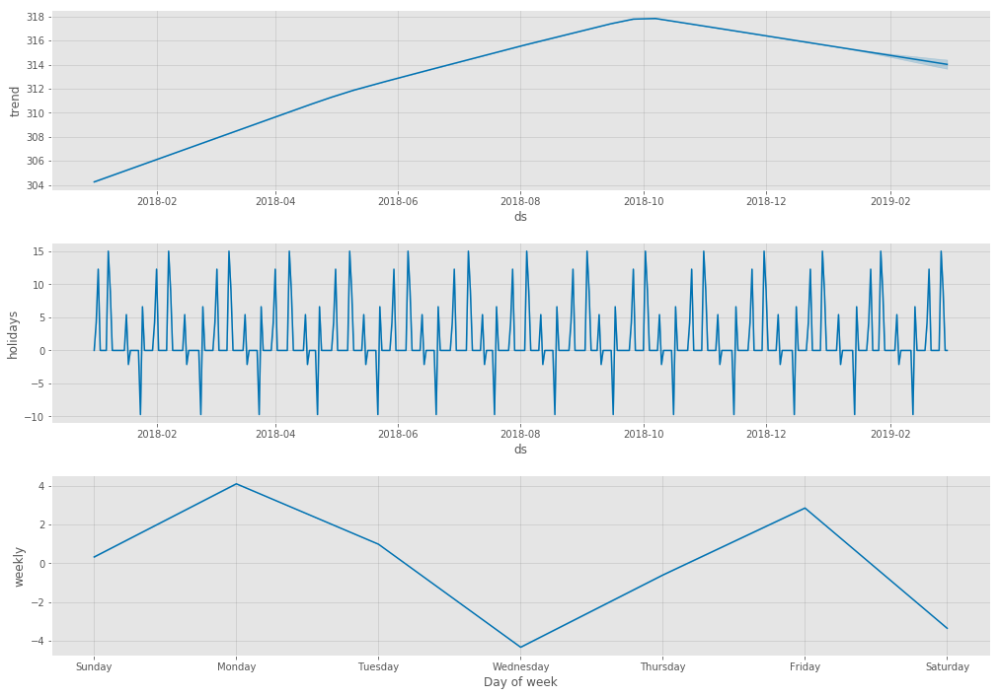

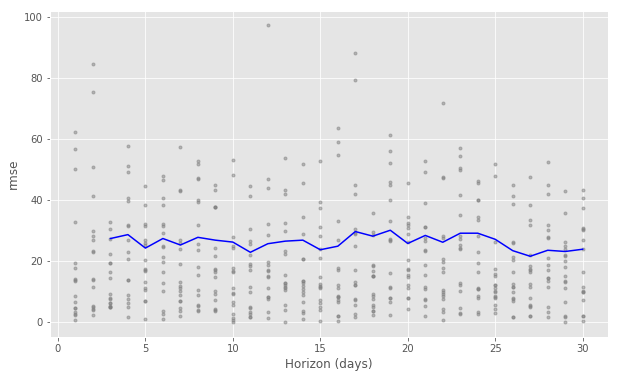

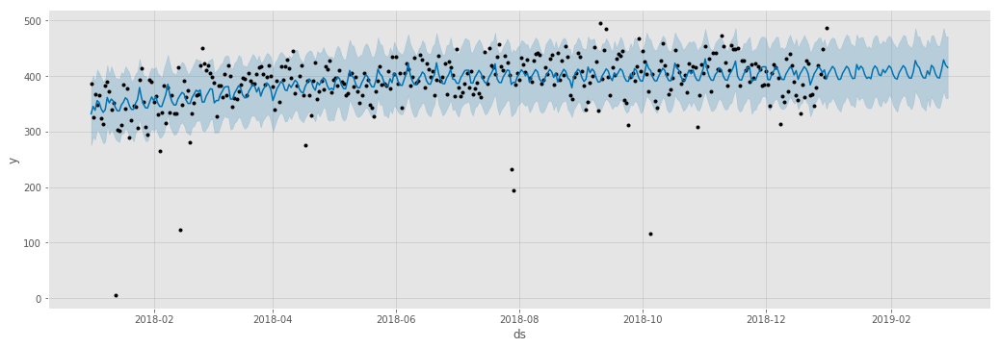

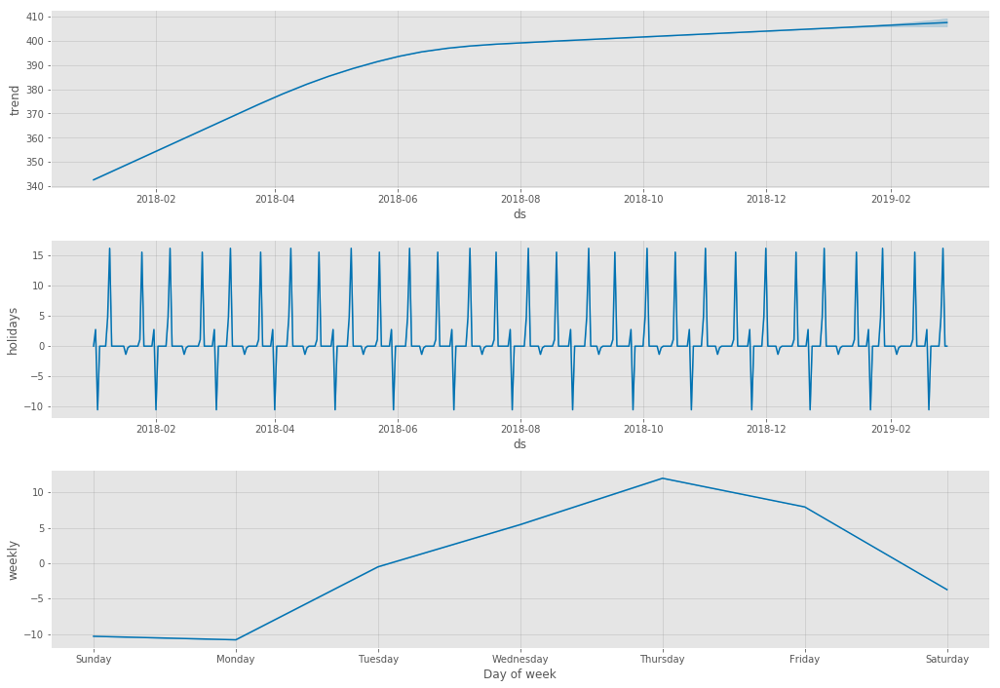

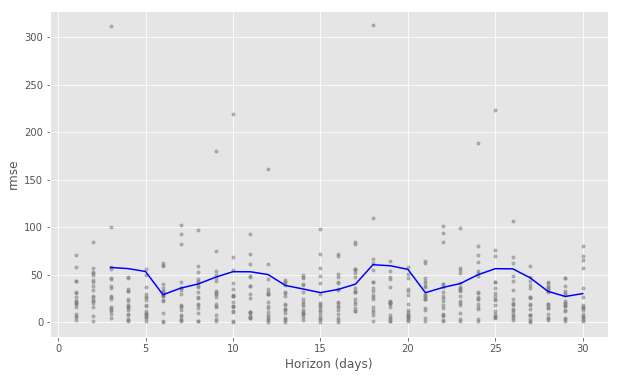

In [30]:
# Running each CSV file through FBPophet
for search in tweet_csv_files:
    tweet_fbprophet(search)

# Panel portion

In [194]:
# Importing .CSV data for use in Panel
quers = ['lovehate','happysad','music','money','nowords','politics', 'coding']
symbols = ['MSFT','EUR','BTC','SP500','SBAC']


lovehate_df = pd.read_csv('tw_lovehate.csv')
lovehate_df.timestamp = pd.to_datetime(lovehate_df.timestamp, infer_datetime_format=True)
happysad_df = pd.read_csv('tw_happysad.csv')
happysad_df.timestamp = pd.to_datetime(happysad_df.timestamp, infer_datetime_format=True)
music_df = pd.read_csv('tw_music.csv')
music_df.timestamp = pd.to_datetime(music_df.timestamp, infer_datetime_format=True)
money_df = pd.read_csv('tw_money.csv')
money_df.timestamp = pd.to_datetime(money_df.timestamp, infer_datetime_format=True)
nowords_df = pd.read_csv('tw_nowords.csv')
nowords_df.timestamp = pd.to_datetime(nowords_df.timestamp, infer_datetime_format=True)
politics_df = pd.read_csv('tw_politics.csv')
politics_df.timestamp = pd.to_datetime(politics_df.timestamp, infer_datetime_format=True)
coding_df = pd.read_csv('tw_coding.csv')
coding_df.timestamp = pd.to_datetime(coding_df.timestamp, infer_datetime_format=True)

MSFT_df = pd.read_csv('MSFT.csv')
MSFT_df.date = pd.to_datetime(MSFT_df.date, infer_datetime_format=True)
EUR_df = pd.read_csv('EUR.csv')
EUR_df.date = pd.to_datetime(EUR_df.date, infer_datetime_format=True)
BTC_df = pd.read_csv('BTC.csv')
BTC_df.date = pd.to_datetime(BTC_df.date, infer_datetime_format=True)
SP500_df = pd.read_csv('SP500.csv')
SP500_df.date = pd.to_datetime(SP500_df.date, infer_datetime_format=True)
SBAC_df = pd.read_csv('SBAC.csv')
SBAC_df.date = pd.to_datetime(SBAC_df.date, infer_datetime_format=True)


# Possible solutions???

  * https://www.youtube.com/watch?v=DGLi-UWReM8
  * https://www.youtube.com/watch?v=k27MJJLJNT4
  * what can Flask do?
  * Dash : https://dash.plot.ly/installation
  
  
  https://holoviz.org/tutorial/Interlinked_Panels.html

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(name='Twitter Query', options={'love OR peace OR hate OR...}, value='tw_lovehate.csv')
    [1] Matplotlib(Figure, tight=True)
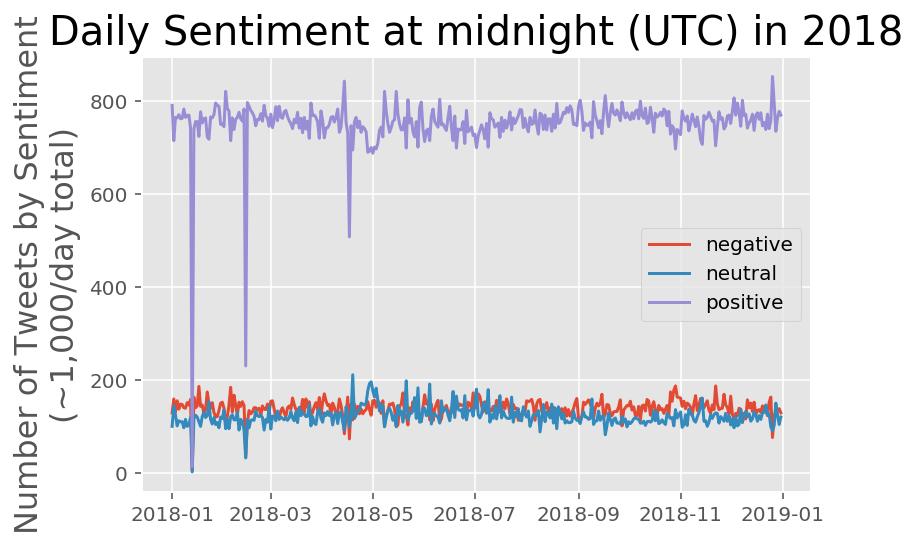

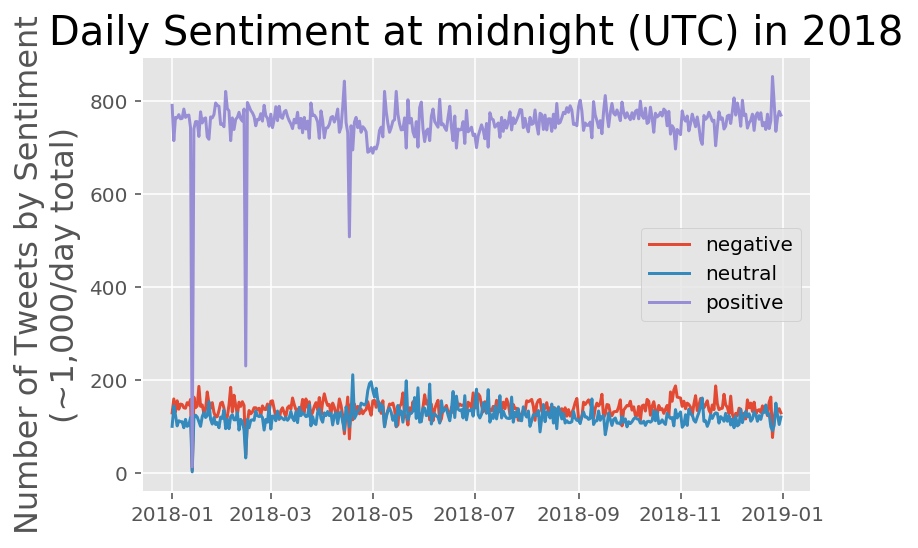

In [260]:
pn.extension()

title = "### Lunar Phases & Human Behavior"

queries = {'love OR peace OR hate OR war':'tw_lovehate.csv',
           'happy OR sad OR life OR death':'tw_happysad.csv',
           'music OR tunes OR dance':'tw_music.csv',
           'stocks OR money OR taxes':'tw_money.csv',
           '(no keywords entered)':'tw_nowords.csv',
           'politics OR government OR Trump':'tw_politics.csv',
           "'data science' OR coding OR programming":'tw_coding.csv'}
moons = {'no phase':'nophase',
         'new moon':'newmoon',
         'first quarter moon':'firstquarter',
         'full moon':'fullmoon',
         'last quarter moon':'lastquarter'}

@pn.depends(query_widget, 
#             moon_widget
           )
def plot_sentiments(query_widget='tw_lovehate.csv'):
    df = pd.read_csv(query_widget)
    df.timestamp = pd.to_datetime(df.timestamp, infer_datetime_format=True)
    fig, ax = plt.subplots()
    for sentiment in df.sentiment.unique():
        temp_df = df[df.sentiment == sentiment]
        x = temp_df['timestamp']
        y = temp_df['tally']
        ax.plot(x, y, label=sentiment)
    plt.ylabel("Number of Tweets by Sentiment\n(~1,000/day total)", fontsize=16)
    plt.title(f"Daily Sentiment at midnight (UTC) in 2018", fontsize=20)
    plt.legend()
    return pn.pane.Matplotlib(fig, tight=True)


# query_choice = pn.pane.Markdown("Please choose an option above")
query_widget = pn.widgets.Select(name='Twitter Query', options=queries, value='tw_lovehate.csv')
# query_widget.link(query_choice, value='object')

# moon_choice = pn.pane.Markdown("Please choose an option above")
# moon_widget = pn.widgets.Select(name='Lunar Phase', options=moons)
# moon_widget.link(moon_choice, value='object')


### Visual layout
# tabs = pn.Tabs(('Daily Sentiment', pn.panel(f'images/tw_{query_widget.value}_sentiment.png', sizing_mode='scale_both')),
#         ('Word Frequency', pn.panel(f'images/tw_{query_widget.value}_{moon_widget.value}.png', sizing_mode='scale_both'))
#     )



def callback(event):
    row[1].object = plot_sentiments(query_widget.value)

    
query_widget.param.watch(callback, 'value')

plurp = pn.panel(plot_sentiments())

row = pn.Row(
    pn.Column(title, 
              query_widget, 
#               moon_widget
             ),
    plurp
    )


row.servable()

In [119]:
pn.extension()

# gspec = pn.GridSpec(sizing_mode='stretch_both', max_height=800, mode='override')

title = "### Lunar Phases & Human Behavior"

queries = {'love OR peace OR hate OR war':'lovehate',
           'happy OR sad OR life OR death':'happysad',
           'music OR tunes OR dance':'music',
           'stocks OR money OR taxes':'money',
           '(no keywords entered)':'nowords',
           'politics OR government OR Trump':'politics',
           "'data science' OR coding OR programming":'coding'}
moons = {'no phase':'nophase',
         'new moon':'newmoon',
         'first quarter moon':'firstquarter',
         'full moon':'fullmoon',
         'last quarter moon':'lastquarter'}


query_choice = pn.pane.Markdown("Please choose an option above")
query_widget = pn.widgets.Select(name='Twitter Query', options=queries, value='nowords')
query_widget.link(query_choice, value='object')

moon_choice = pn.pane.Markdown("Please choose an option above")
moon_widget = pn.widgets.Select(name='Lunar Phase', options=moons, value='')
moon_widget.link(moon_choice, value='object')
pn.Column(query_widget, query_choice, moon_widget, moon_choice)


Column
    [0] Select(name='Twitter Query', options={'love OR peace OR hate OR...}, value='nowords')
    [1] Markdown(str)
    [2] Select(name='Lunar Phase', options={'no phase': 'nophase', ...}, value='nophase')
    [3] Markdown(str)

In [121]:
f"{query_widget.value}_2018"

'happysad_2018'

In [101]:
@pn.depends(query_widget, moon_widget)

def plot_sentiments(query_widget):
    csv_filename=f"tw_{query_widget.value}_2018.csv"
    year=2018
    tweets_df = pd.read_csv(csv_filename)
    tweets_df.timestamp = pd.to_datetime(tweets_df.timestamp, format='%Y%m%d')
    grouped = pd.DataFrame(tweets_df.groupby(['timestamp', 'sentiment'])['tally'].sum()).reset_index()
    fig, ax = plt.subplots()
    for sentiment in grouped.sentiment.unique():
        temp_df = grouped[grouped.sentiment == sentiment]
        x = temp_df['timestamp']
        y = temp_df['tally']
        ax.plot(x, y, label=sentiment)
    plt.ylabel("Number of Tweets by Sentiment\n(~1,000/day total)", fontsize=16)
    plt.title(f"Daily Sentiment at midnight (UTC) in {year}", fontsize=20)
    plt.legend()
    return pn.pane.Matplotlib(fig, tight=True)


# function to get most frequent words
def get_top_n_words(corpus, stopwords):
    vec = CountVectorizer(stop_words=stopwords).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq


# function for plotting the most frequent words
def plot_phase_words(corpus, keywords, phase, stopwords, n=None):
    comm_words = get_top_n_words(corpus.text, stopwords)[:n]
    df2 = pd.DataFrame(comm_words, columns=['text', 'count'])
    total = df2['count'].sum()   ###################    
    # plotting
    fig, ax = plt.subplots(figsize=(15,5))
    plt.xticks(rotation=30, fontsize=14)
    hghts = ((df2['count'] / total) * 100)
    rects = ax.bar(df2.text, hghts)                                                  #################
    ax.set_title(f"Top {n} Words for {phase} at Midnight UTC", fontsize=16)
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width(), 1.005*height,
                f'{np.round(height, 2)}%', ha='right', va='bottom')
    plt.plot([], [], ' ', label=f"Search Keywords:\n{keywords}")
    plt.legend(fontsize=14)
    plt.show();


# function to parse a CSV file and then plot all results
def plot_CSV_words(filename, keywords, phases_df, n=None):
    """
    Inputs:
    filename       (str) CSV filename generated from Twitter scraping function
    keywords       (str) the query keywords used in Twitter scraping function
    phases_df      (df) dataframe of lunar phases for a given year
    n              (int) number of most common words to return
    ==================================================
    Returns:
    Histograms (5 total) of the 'n' most common words for each lunar phase and for
    all the nights not in a lunar phase.
    """
    df = pd.read_csv(filename)
    df.dropna(inplace=True)
    df.timestamp = pd.to_datetime(df.timestamp, format='%Y%m%d')  
    stopwords = set(ENGLISH_STOP_WORDS)
    # now add extra things to that list that we want to filter out
    stopwords.update(['twitter','com','pic','ve','ll','just','like','don','really','00'])
    df.set_index('timestamp', inplace=True)
    
    phase_list = ['Full Moon','Last Quarter','New Moon','First Quarter','No Phase']
    for phase in phase_list:
        all_moons = list(phases_df.date.astype(str))
        if phase != 'No Phase':
            moon = list(phases_df[phases_df.phase == phase].date.astype(str))
            moon_data = df.loc[df.index.floor('D').isin(moon)]
            plot_phase_words(moon_data, keywords, phase, stopwords, n=n)
        else:
            moon_data = df.loc[~df.index.floor('D').isin(all_moons)]
            plot_phase_words(moon_data, keywords, phase, stopwords, n=n)

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(name='Twitter Query', options={'love OR peace OR hate OR...}, value='lovehate')
        [2] Select(name='Lunar Phase', options={'no phase': 'nophase', ...}, value='nophase')
    [1] PNG(str, sizing_mode='scale_both')
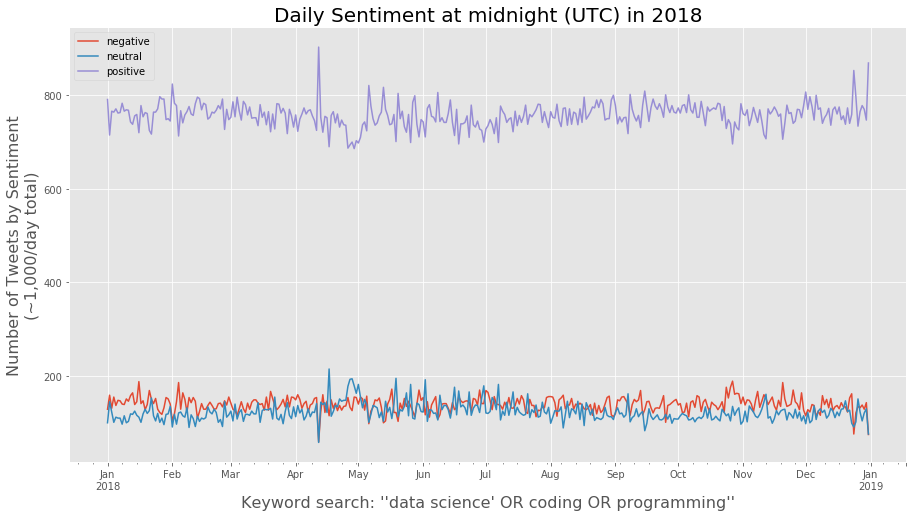

In [133]:
# query_choice = pn.pane.Markdown("Please choose an option above")
query_widget = pn.widgets.Select(name='Twitter Query', options=queries)
# query_widget.link(query_choice, value='object')

# moon_choice = pn.pane.Markdown("Please choose an option above")
moon_widget = pn.widgets.Select(name='Lunar Phase', options=moons)
# moon_widget.link(moon_choice, value='object')


# Visual layout

# tabs = pn.Tabs(('Daily Sentiment', pn.panel(f'images/tw_{query_widget.value}_sentiment.png', sizing_mode='scale_both')),
#         ('Word Frequency', pn.panel(f'images/tw_{query_widget.value}_{moon_widget.value}.png', sizing_mode='scale_both'))
#     )
row = pn.Row(
    pn.Column(title, query_widget, moon_widget),
    pn.panel(f'images/tw_{query_widget.value}_sentiment.png', sizing_mode='scale_both')
    )


### documentation example:
# row = pn.Row(
#     pn.Column(title, ticker, window),
#     get_plot(ticker.options[0], window.value)
# )


def update(event):
    row[1].object = pn.panel(f'images/tw_{query_widget.value}_sentiment.png', sizing_mode='scale_both')

query_widget.param.watch(fn=update, what='value', onlychanged=False)
moon_widget.param.watch(fn=update, what='value', onlychanged=False)

row.servable()

In [135]:
query_widget.value

'music'

In [ ]:
d

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(name='Twitter Query', options={'love OR peace OR hate OR...}, value='lovehate')
    [1] Tabs
        [0] PNG(str, sizing_mode='scale_both')
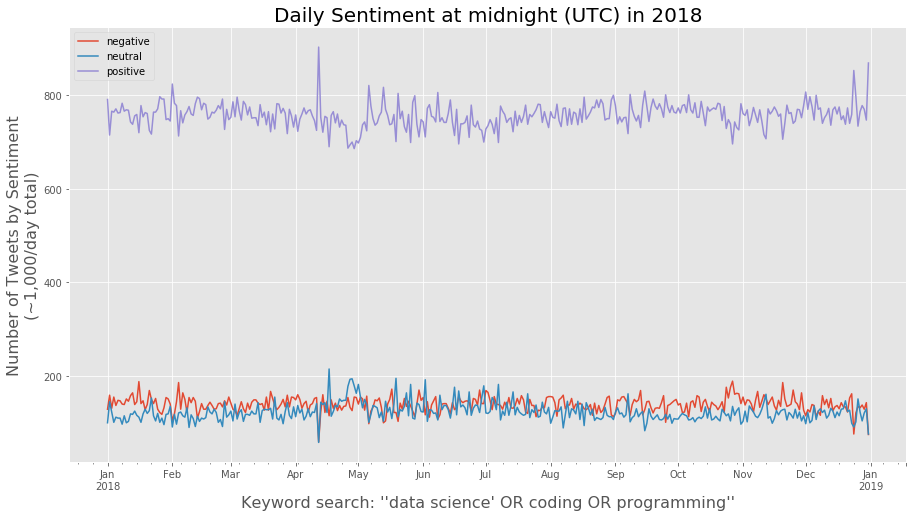

In [149]:
@pn.depends(query_widget.value)
def get_sentiment_img_path(query):
    return f'images/tw_{query}_sentiment.png'

# def get_word_freq_img_path(query, moon):
#     return f'images/tw_{query}_{moon}.png'

def callback(event):
    sent_graph.object = pn.panel(get_sentiment_img_path(event.new), sizing_mode='scale_both')


# This code properly displays graphs, but does not respond to user inputs 
query_widget = pn.widgets.Select(name='Twitter Query', options=queries)
# moon_widget = pn.widgets.Select(name='Lunar Phase', options=moons)
sent_graph = pn.panel(get_sentiment_img_path(query_widget.value), sizing_mode='scale_both')
# word_freq_graph = pn.panel(get_word_freq_img_path(query_widget.value, moon_widget.value), sizing_mode='scale_both')

# links
# query_widget.link(sent_graph, value="object")
# moon_widget.link(word_freq_graph,)

# watching
query_widget.param.watch(get_sentiment_img_path, 'value')



# Visual layout
pn.Row(
    pn.Column(title, 
              query_widget, 
#               moon_widget
             ),
    pn.Tabs(('Daily Sentiment', sent_graph),
#             ('Word Frequency', pn.panel(get_word_freq_img_path(query_widget.value, moon_widget.value), sizing_mode='scale_both'))
           )
    )

# pn.Row(<rmse_graph?>,<seasonality_graph?>)

In [122]:
# ##### Visual layout ---- more advanced....hasn't worked properly yet ####
# pn.Row(
#     pn.Column(title, query_widget, moon_widget),
#     pn.Tabs(('Daily Sentiment', plot_sentiments(query_widget)),
# #             ('Word Frequency', plot_CSV_words()),
# #             ('Explorable Graph', pn.widgets.ColorPicker())
#            )
#     )

# pn.Row(<rmse_graph?>,<seasonality_graph?>)




#### Grid-based layout (grid sizes do not appear to play nicely) ###
# gspec[0,0] = pn.Column(title, query_widget, moon_widget)
# gspec[0,1:2] = pn.Tabs(('Daily Sentiment', plot_sentiments(query_widget)))
## gspec[0, 1:3] = pn.Spacer(background='#000000')
## gspec[1:3, 1:3] = fig
## gspec[3:5, 0] = hv.Curve([1, 2, 3])
## gspec[3:5, 1] = 'https://upload.wikimedia.org/wikipedia/commons/4/47/PNG_transparency_demonstration_1.png'
## gspec[4:5, 2] = pn.Column(
##     pn.widgets.FloatSlider(),
##     pn.widgets.ColorPicker(),
##     pn.widgets.Toggle(name='Toggle Me!'))
# gspec

In [176]:
bokeh.__version__

'1.3.4'

In [184]:
import bokeh
from bokeh.plotting import figure, show

In [173]:
sent_df = pd.read_csv("tweets_lovehate_2018.csv")

In [174]:
sent_df.head()

,timestamp,text,sentiment,polarity,subjectivity,tally
0,20180101,i hate everyone.... naaa.. i just hate people...,negative,-0.800000,0.900000,1
1,20180101,I love how your new label is taking everything...,positive,0.387273,0.550909,1
2,20180101,I'll love you 'till my breathing stops...,positive,0.500000,0.600000,1
3,20180101,"If RDR2 has loot boxes, I hope that 1/10 of th...",positive,0.150000,0.700000,1
4,20180101,Love love luv you more,positive,0.500000,0.566667,1


In [185]:
bokeh_p = figure(title="sentiment graph", x_axis_type='datetime')

bokeh_p.multi_line(xs = [sent_df.timestamp.values]*3,
                   ys = [sent_df[sent_df['sentiment']==sent]['tally'].values for sent in sent_df.sentiment.unique()])

show(bokeh_p)

In [155]:
def get_query_value(key):
    queries = {'love OR peace OR hate OR war':'lovehate',
               'happy OR sad OR life OR death':'happysad',
               'music OR tunes OR dance':'music',
               'stocks OR money OR taxes':'money',
               '(no keywords entered)':'nowords',
               'politics OR government OR Trump':'politics',
               "'data science' OR coding OR programming":'coding'}
    return queries[key]

moons = {'no phase':'nophase',
         'new moon':'newmoon',
         'first quarter moon':'firstquarter',
         'full moon':'fullmoon',
         'last quarter moon':'lastquarter'}

In [171]:
class DashBoard(param.Parameterized):
    
    
    query_widget = pn.widgets.Select(name='Twitter Query', options=queries)
    # sent_graph = pn.panel(get_sentiment_img_path(query_widget.value), sizing_mode='scale_both')

    @param.depends(query_widget.value)
    def get_sentiment_img_path(query='lovehate'):
        return f'images/tw_{query}_sentiment.png'


    @param.depends('query_widget')
    def get_query_value(self):
        return 


mypanel = pn.Row(
    pn.Column('## Widgets', query_widget, get_query_value('lovehate'), get_sentiment_img_path()))

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(name='Twitter Query', options={'love OR peace OR hate OR...}, value='lovehate')
        [2] Markdown(str)
        [3] PNG(str)
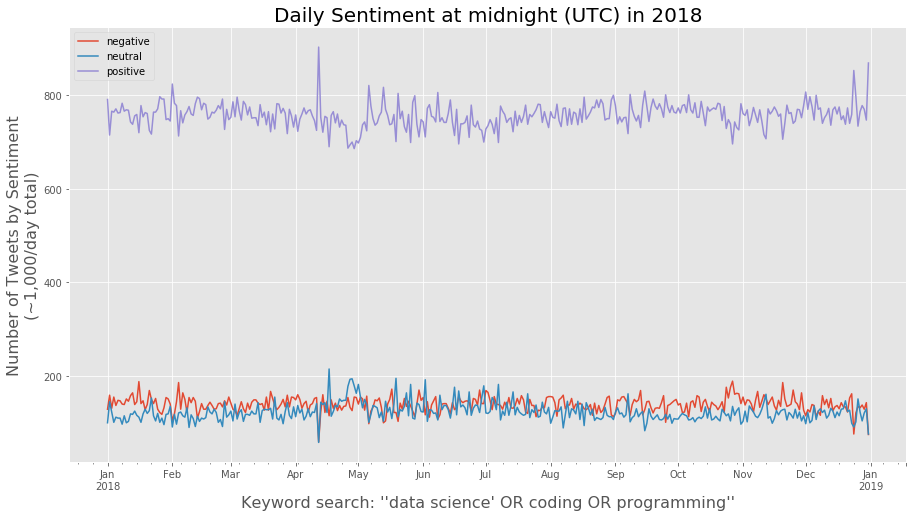

In [172]:
mypanel.servable()

In [62]:
# import panel as pn
# import pandas as pd
# import hvplot.pandas

# from bokeh import stocks

# pn.extension()

In [ ]:
# mandatory fields for later implementation options

title = '## Stock Explorer hvPlot'
tickers = ['AAPL', 'FB', 'GOOG', 'IBM', 'MSFT']

def get_df(ticker, window_size):
    df = pd.DataFrame(getattr(stocks, ticker))
    df['date'] = pd.to_datetime(df.date)
    return df.set_index('date').rolling(window=window_size).mean().reset_index()

def get_plot(ticker, window_size):
    df = get_df(ticker, window_size)
    return df.hvplot.line('date', 'close', grid=True)

In [ ]:
# Interact method

interact = pn.interact(get_plot, ticker=tickers, window_size=(1, 21, 5))
pn.Row(
    pn.Column(title, interact[0]),
    interact[1]
)

In [ ]:
# Reactive method

ticker = pn.widgets.Select(name='Ticker', options=tickers)
window = pn.widgets.IntSlider(name='Window Size', value=6, start=1, end=21)

@pn.depends(ticker, window)
def get_plot(ticker, window_size):
    df = get_df(ticker, window_size)
    return df.hvplot.line('date', 'close', grid=True)

pn.Row(
    pn.Column(title, ticker, window),
    get_plot
)

In [ ]:
# Parameterized class method

import param

class StockExplorer(param.Parameterized):
    
    ticker = param.Selector(default='AAPL', objects=tickers)  
    window_size = param.Integer(default=6, bounds=(1, 21))
    
    @param.depends('ticker', 'window_size')
    def plot(self):
        return get_plot(self.ticker, self.window_size)
    
explorer = StockExplorer(name='Stock Explorer hvPlot')
pn.Row(explorer.param, explorer.plot)

In [ ]:
# Callbacks method

ticker = pn.widgets.Select(name='Ticker', options=['AAPL', 'FB', 'GOOG', 'IBM', 'MSFT'])
window = pn.widgets.IntSlider(name='Window', value=6, start=1, end=21)

row = pn.Row(
    pn.Column(title, ticker, window),
    get_plot(ticker.options[0], window.value)
)

def update(event):
    row[1].object = get_plot(ticker.value, window.value)

ticker.param.watch(update, 'value')
window.param.watch(update, 'value')

row.servable()